# Self-Driving Car Engineer Nanodegree
## Advanced Lane Finding
---
In this project, I'll write a software pipeline to identify the lane boundaries in a video.

## Import Packages

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import ntpath

%matplotlib inline

## Calibrate Camera

### Calibration Images

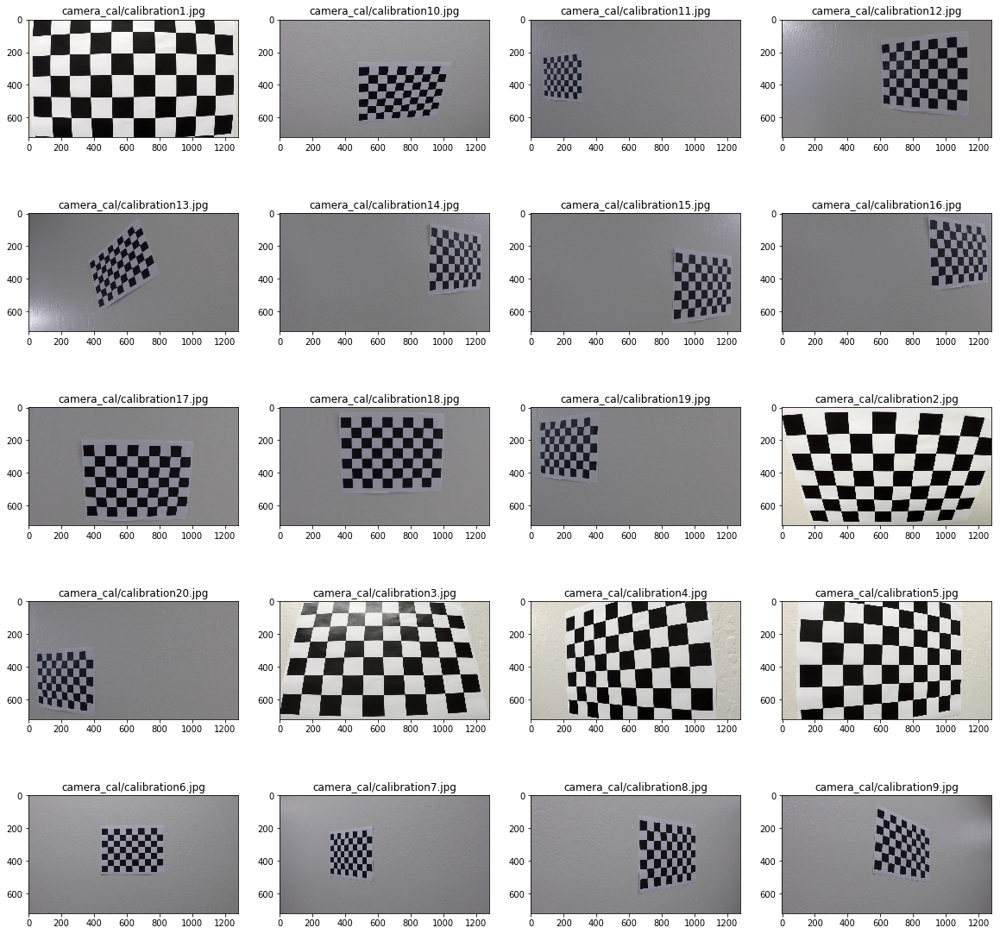

In [2]:
cal_images = sorted(glob.glob('camera_cal/*.jpg'))

fig = plt.figure(figsize = (20, 20))
for i in range(len(cal_images)):
    cal_image = cal_images[i]
    image = mpimg.imread(cal_image)

    ax = fig.add_subplot(5,4,i+1)
    ax.set_title(cal_image)
    ax.imshow(image.squeeze())

### Find Corners

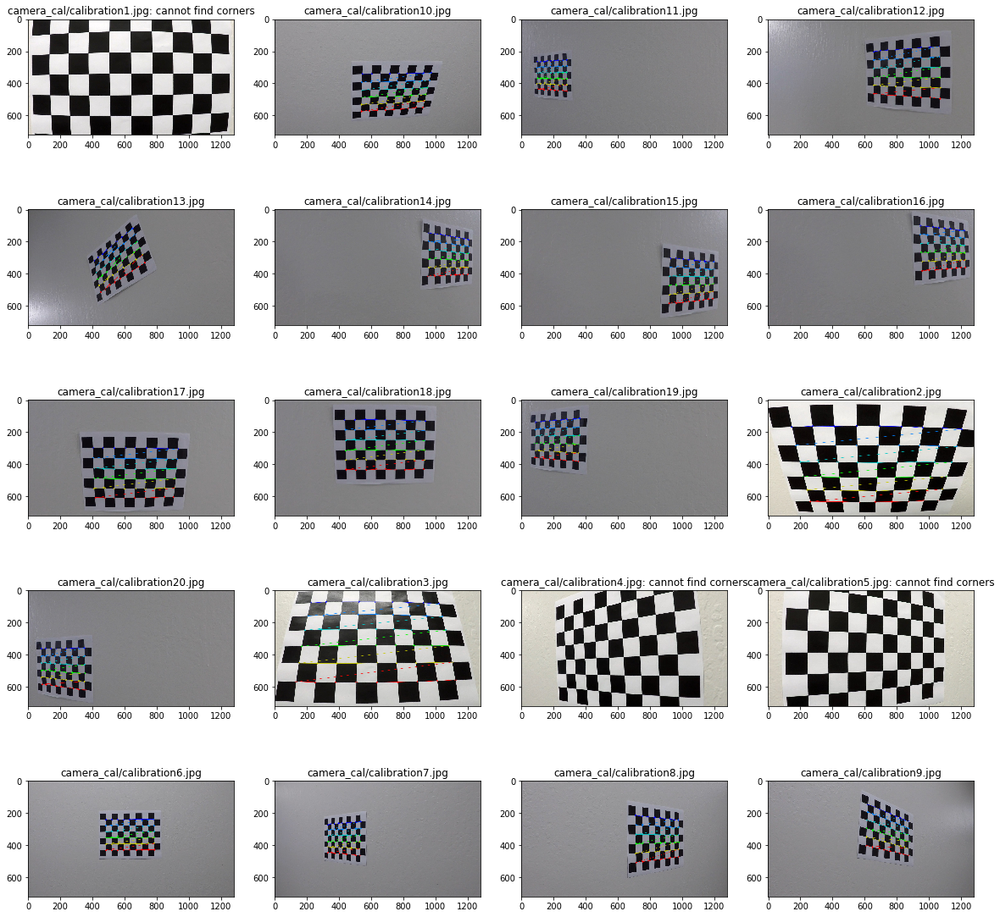

In [3]:
object_points = []
image_points = []

# Array to store object points and image points from all the calibration images
objp = np.zeros((6*9, 3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

fig = plt.figure(figsize = (20, 20))
for i in range(len(cal_images)):
    cal_image = cal_images[i]
    image = mpimg.imread(cal_image)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
    
    if ret == True:
        image_points.append(corners)
        object_points.append(objp)
        corner_image = cv2.drawChessboardCorners(image, (9, 6), corners, ret)

        ax = fig.add_subplot(5,4,i+1)
        ax.set_title(cal_image)
        ax.imshow(corner_image)
    else:
        ax = fig.add_subplot(5,4,i+1)
        ax.set_title(cal_image + ': cannot find corners')
        ax.imshow(image)

### Undistort Images

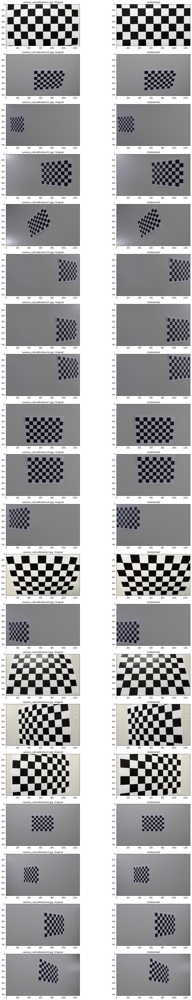

In [4]:
camera_mtx = None
camera_dist = None

def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    camera_mtx = mtx
    camera_dist = dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

fig = plt.figure(figsize = (20, 100))
for i in range(len(cal_images)):
    cal_image = cal_images[i]
    image = mpimg.imread(cal_image)
    undist = cal_undistort(image, object_points, image_points)

    ax1 = fig.add_subplot(20,2,(i*2)+1)
    ax1.set_title(cal_image + ': Original')
    ax1.imshow(image)
    ax2 = fig.add_subplot(20,2,(i*2)+2)
    ax2.set_title('Undistorted')
    ax2.imshow(undist)

## Test Images

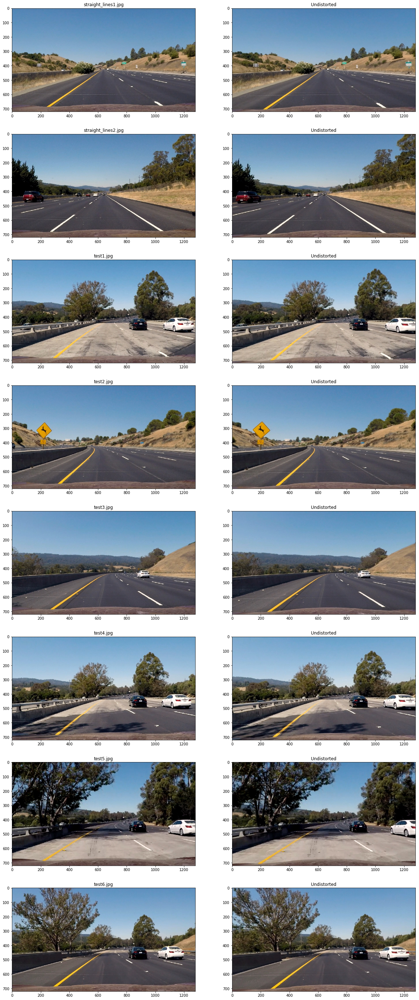

In [5]:
test_images = sorted(glob.glob('test_images/*.jpg'))

fig = plt.figure(figsize = (20, 50))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)

    ax1 = fig.add_subplot(8,2,(i*2)+1)
    ax1.set_title(ntpath.basename(test_image))
    ax1.imshow(image.squeeze())
    ax2 = fig.add_subplot(8,2,(i*2)+2)
    ax2.set_title('Undistorted')
    ax2.imshow(undist)

## Color Transform and Gradients

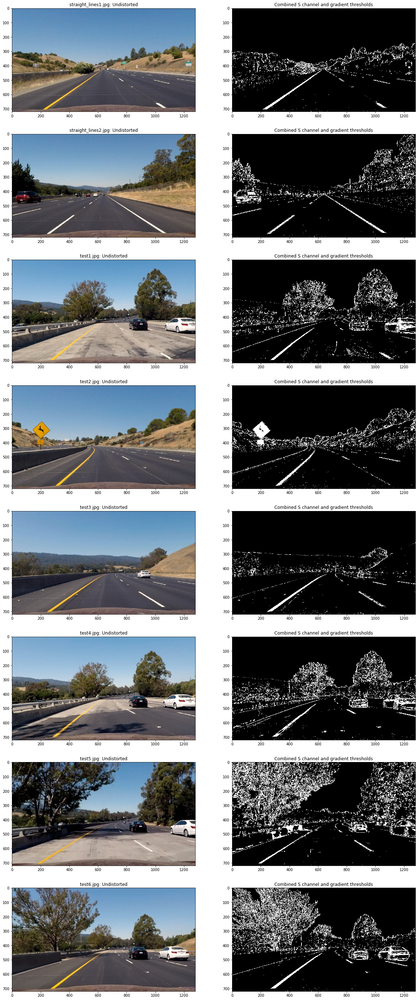

In [6]:
def binary(img):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]

    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Threshold color channel
    s_thresh_min = 170
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

    return combined_binary

fig = plt.figure(figsize = (20, 50))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)
    image_binary = binary(undist)

    ax1 = fig.add_subplot(8,2,(i*2)+1)
    ax1.set_title(ntpath.basename(test_image) + ': Undistorted')
    ax1.imshow(undist)
    ax2 = fig.add_subplot(8,2,(i*2)+2)
    ax2.set_title('Combined S channel and gradient thresholds')
    ax2.imshow(image_binary, cmap='gray')

## Perspective Transform

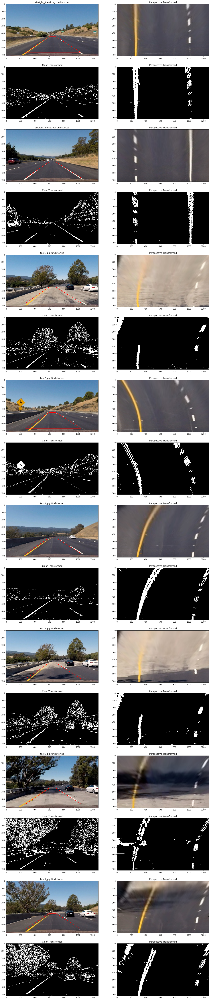

In [7]:
warp_src = np.float32([[595, 450],
                       [690, 450],
                       [1040, 670],
                       [270, 670]])

warp_dst = np.float32([[250,0],
                       [1030,0],
                       [1030,720],
                       [250,720]])

M = cv2.getPerspectiveTransform(warp_src, warp_dst)

M_inv = cv2.getPerspectiveTransform(warp_dst, warp_src)

def warp(img):
    img_size = img.shape[1::-1]
    warped = cv2.warpPerspective(img, M, img_size)
    return warped

def draw_region(img):
    cv2.polylines(img,[np.array(warp_src, np.int32).reshape((-1,1,2))],True,(255,0,0), thickness = 2)

fig = plt.figure(figsize = (20, 100))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)
    warp_image = warp(undist)
    image_binary = binary(undist)
    warp_binary = warp(image_binary)
    draw_region(undist)

    ax1 = fig.add_subplot(16,2,(i*4)+1)
    ax1.set_title(ntpath.basename(test_image) + ': Undistorted')
    ax1.imshow(undist)
    ax2 = fig.add_subplot(16,2,(i*4)+2)
    ax2.set_title('Perspective Transformed')
    ax2.imshow(warp_image, cmap='gray')
    ax3 = fig.add_subplot(16,2,(i*4)+3)
    ax3.set_title('Color Transformed')
    ax3.imshow(image_binary, cmap='gray')
    ax4 = fig.add_subplot(16,2,(i*4)+4)
    ax4.set_title('Perspective Transformed')
    ax4.imshow(warp_binary, cmap='gray')

## Finding the Lane

### Histogram

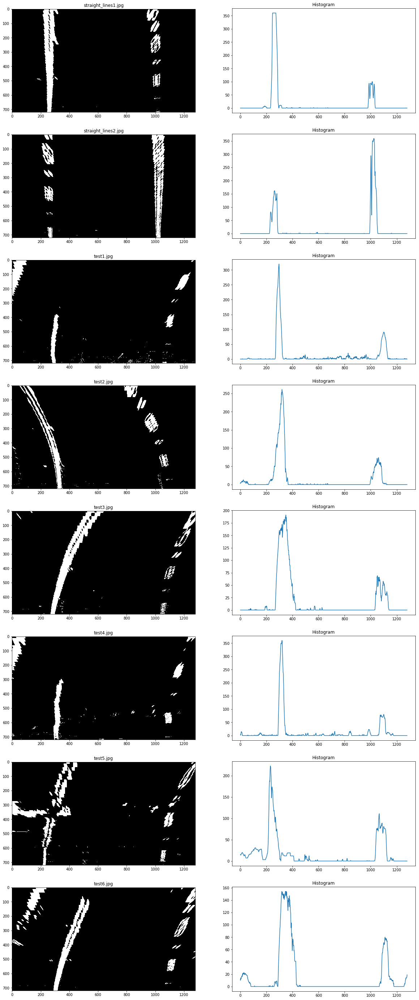

In [8]:
def histogram(img):
    img_histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    return img_histogram

fig = plt.figure(figsize = (20, 50))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)
    image_binary = binary(undist)
    warp_binary = warp(image_binary)
    image_histogram = histogram(warp_binary)

    ax1 = fig.add_subplot(8,2,(i*2)+1)
    ax1.set_title(ntpath.basename(test_image))
    ax1.imshow(warp_binary, cmap='gray')
    ax2 = fig.add_subplot(8,2,(i*2)+2)
    ax2.set_title('Histogram')
    ax2.plot(image_histogram)

### Helper Class

In [9]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = True  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

### Find and Highlight Lane Lines

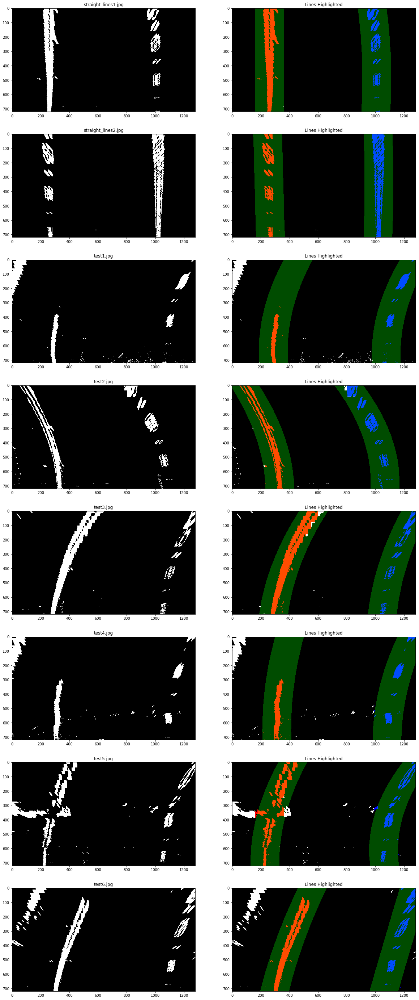

In [10]:
def detect_lines_inner(img, left_line_inds, right_line_inds, nonzerox, nonzeroy, margin):
    left_line = Line()
    right_line = Line()

    # Again, extract left and right line pixel positions
    left_line.allx = nonzerox[left_line_inds]
    left_line.ally = nonzeroy[left_line_inds] 
    right_line.allx = nonzerox[right_line_inds]
    right_line.ally = nonzeroy[right_line_inds] 
    # Fit a second order polynomial to each
    left_line.current_fit = np.polyfit(left_line.ally, left_line.allx, 2)
    right_line.current_fit = np.polyfit(right_line.ally, right_line.allx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    left_fitx = left_line.current_fit[0]*ploty**2 + left_line.current_fit[1]*ploty + left_line.current_fit[2]
    right_fitx = right_line.current_fit[0]*ploty**2 + right_line.current_fit[1]*ploty + right_line.current_fit[2]

    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    out_img = np.dstack((img, img, img))*255
    out_img[nonzeroy[left_line_inds], nonzerox[left_line_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_line_inds], nonzerox[right_line_inds]] = [0, 0, 255]

    # Create an output image to draw on and  visualize the result
    window_img = np.zeros_like(out_img)

    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return result, left_line, right_line

def detect_lines(img, highlight = True):
    margin = 100

    image_histogram = histogram(img)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(image_histogram.shape[0]/2)
    leftx_base = np.argmax(image_histogram[:midpoint])
    rightx_base = np.argmax(image_histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right line pixel indices
    left_line_inds = []
    right_line_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_line_inds.append(good_left_inds)
        right_line_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_line_inds = np.concatenate(left_line_inds)
    right_line_inds = np.concatenate(right_line_inds)

    return detect_lines_inner(img, left_line_inds, right_line_inds, nonzerox, nonzeroy, margin)

fig = plt.figure(figsize = (20, 50))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)
    image_binary = binary(undist)
    warp_binary = warp(image_binary)
    lines_highlighted, left_line, right_line = detect_lines(warp_binary)

    ax1 = fig.add_subplot(8,2,(i*2)+1)
    ax1.set_title(ntpath.basename(test_image))
    ax1.imshow(warp_binary, cmap='gray')
    ax2 = fig.add_subplot(8,2,(i*2)+2)
    ax2.set_title('Lines Highlighted')
    ax2.imshow(lines_highlighted)

### Calculating Curvature

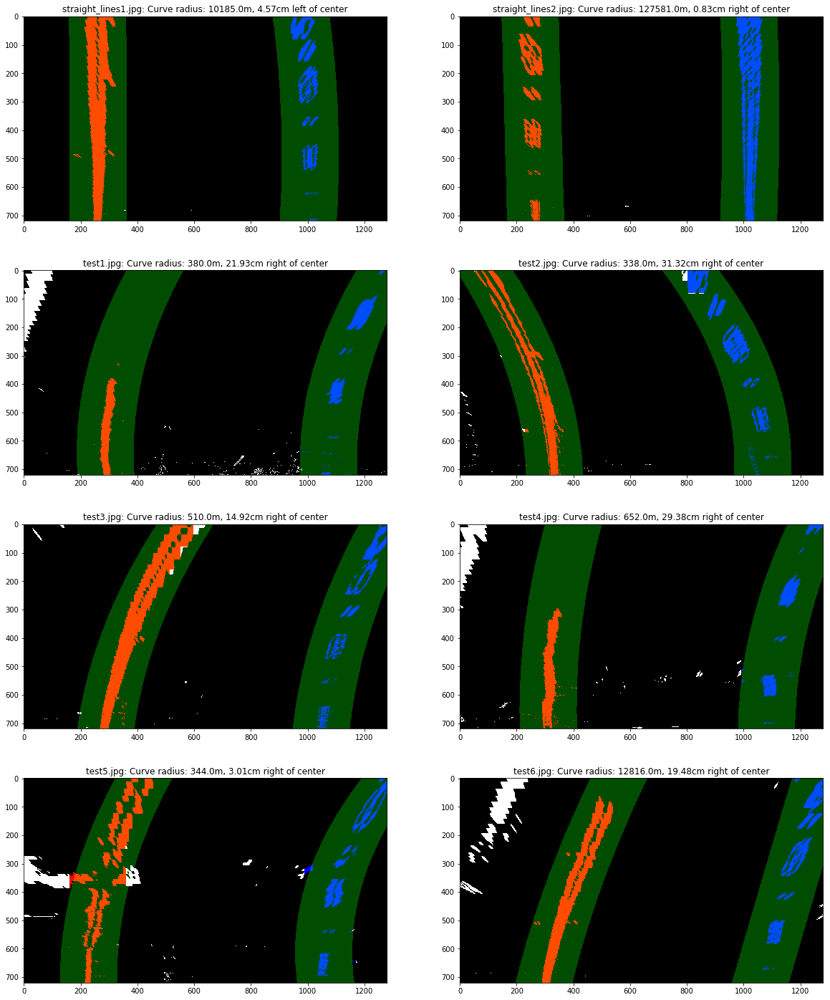

In [11]:
def cal_curvature_and_pos(left_line, right_line):
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = 720
    width = 1280

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(left_line.ally*ym_per_pix, left_line.allx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(right_line.ally*ym_per_pix, right_line.allx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_line.radius_of_curvature = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_line.radius_of_curvature = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters

    left_bottom_x = left_line.current_fit[0]*y_eval**2 + left_line.current_fit[1]*y_eval + left_line.current_fit[2]
    right_bottom_x = right_line.current_fit[0]*y_eval**2 + right_line.current_fit[1]*y_eval + right_line.current_fit[2]
    # Line position respective to center of image

    left_line.line_base_pos = (left_bottom_x - (width/2)) * xm_per_pix
    right_line.line_base_pos = (right_bottom_x - (width/2)) * xm_per_pix
    
fig = plt.figure(figsize = (20, 25))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    undist = cal_undistort(image, object_points, image_points)
    image_binary = binary(undist)
    warp_binary = warp(image_binary)
    lines_highlighted, left_line, right_line = detect_lines(warp_binary)
    cal_curvature_and_pos(left_line, right_line)

    curverad = round((left_line.radius_of_curvature + right_line.radius_of_curvature) / 2)
    curverad_str = 'Curve radius: ' + str(curverad) + 'm'
    lane_base_pos = round((left_line.line_base_pos + right_line.line_base_pos) / 2, 4)
    if lane_base_pos > 0:
        position_str = str(lane_base_pos * 100) + 'cm right of center'
    elif lane_base_pos < 0:
        position_str = str(lane_base_pos * -100) + 'cm left of center'
    else:
        position_str = 'right at center'
    ax = fig.add_subplot(4,2,i+1)
    ax.set_title(ntpath.basename(test_image) + ': ' + curverad_str + ', ' + position_str)
    ax.imshow(lines_highlighted)

### Detect Lines Starting from Previous Lines

In [12]:
def detect_lines_from_previous_lines(img, prev_left_line, prev_right_line):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_line_inds = ((nonzerox > (prev_left_line.current_fit[0]*(nonzeroy**2) + prev_left_line.current_fit[1]*nonzeroy + 
    prev_left_line.current_fit[2] - margin)) & (nonzerox < (prev_left_line.current_fit[0]*(nonzeroy**2) + 
    prev_left_line.current_fit[1]*nonzeroy + prev_left_line.current_fit[2] + margin))) 

    right_line_inds = ((nonzerox > (prev_right_line.current_fit[0]*(nonzeroy**2) + prev_right_line.current_fit[1]*nonzeroy + 
    prev_right_line.current_fit[2] - margin)) & (nonzerox < (prev_right_line.current_fit[0]*(nonzeroy**2) + 
    prev_right_line.current_fit[1]*nonzeroy + prev_right_line.current_fit[2] + margin)))  

    return detect_lines_inner(img, left_line_inds, right_line_inds, nonzerox, nonzeroy, margin)

### Draw Lane

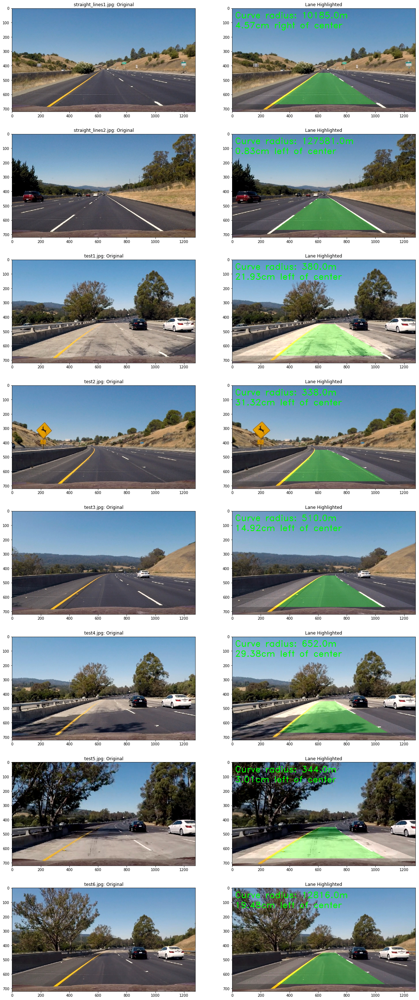

In [13]:
left_line = None
right_line = None

def draw_lane(img):
    global left_line
    global right_line
    prev_left_line = None
    prev_right_line = None

    y_eval = 720

    undist = cal_undistort(img, object_points, image_points)
    warp_image = warp(undist)
    image_binary = binary(undist)
    warp_binary = warp(image_binary)
    if left_line == None or right_line == None or left_line.detected or not right_line.detected:
        lines_highlighted, left_line, right_line = detect_lines(warp_binary)
    else:
        prev_left_line, prev_right_line = left_line, right_line
        lines_highlighted, left_line, right_line = detect_lines_from_previous_lines(warp_binary, left_line, right_line)
        
    cal_curvature_and_pos(left_line, right_line)

    if prev_left_line is not None and (abs(left_line.line_base_pos - prev_left_line.line_base_pos) / prev_left_line.line_base_pos) > 0.1:
        left_line.detected = False
    if prev_right_line is not None and (abs(right_line.line_base_pos - prev_right_line.line_base_pos) / prev_right_line.line_base_pos) > 0.1:
        right_line.detected = False

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warp_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    left_fitx = left_line.current_fit[0]*ploty**2 + left_line.current_fit[1]*ploty + left_line.current_fit[2]
    right_fitx = right_line.current_fit[0]*ploty**2 + right_line.current_fit[1]*ploty + right_line.current_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(warp_image, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(warp_image, M_inv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    curverad = round((left_line.radius_of_curvature + right_line.radius_of_curvature) / 2)
    curverad_str = 'Curve radius: ' + str(curverad) + 'm'
    lane_base_pos = round((left_line.line_base_pos + right_line.line_base_pos) / 2, 4)
    if lane_base_pos > 0:
        position_str = str(lane_base_pos * 100) + 'cm left of center'
    elif lane_base_pos < 0:
        position_str = str(lane_base_pos * -100) + 'cm right of center'
    else:
        position_str = 'right at center'
    cv2.putText(result, curverad_str, (20, 70), cv2.FONT_HERSHEY_DUPLEX, 2, (0,255, 0), 2, cv2.LINE_AA)
    cv2.putText(result, position_str, (20, 140), cv2.FONT_HERSHEY_DUPLEX, 2, (0,255, 0), 2, cv2.LINE_AA)
    return result

fig = plt.figure(figsize = (20, 50))
for i in range(len(test_images)):
    test_image = test_images[i]
    image = mpimg.imread(test_image)
    left_line = None
    right_line = None
    output_image = draw_lane(image)

    ax1 = fig.add_subplot(8,2,(i*2)+1)
    ax1.set_title(ntpath.basename(test_image) + ': Original')
    ax1.imshow(image)
    ax2 = fig.add_subplot(8,2,(i*2)+2)
    ax2.set_title('Lane Highlighted')
    ax2.imshow(output_image)

## Video

### Import Packages

In [14]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### Basic Video

In [15]:
left_line = None
right_line = None

video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(draw_lane)
%time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [20:52<00:01,  1.07s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 21min 37s, sys: 47.2 s, total: 22min 24s
Wall time: 20min 53s


In [16]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Challenge Video

In [17]:
left_line = None
right_line = None

challenge_video_output = 'challenge_video_output.mp4'
challenge_video_input = VideoFileClip('challenge_video.mp4')
processed_challenge_video = challenge_video_input.fl_image(draw_lane)
%time processed_challenge_video.write_videofile(challenge_video_output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [07:56<00:00,  1.05it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 8min 14s, sys: 15 s, total: 8min 29s
Wall time: 7min 57s


In [18]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_video_output))

### Harder Challenge Video

In [19]:
left_line = None
right_line = None

harder_challenge_video_output = 'harder_challenge_video_output.mp4'
harder_challenge_video_input = VideoFileClip('harder_challenge_video.mp4')
processed_harder_challenge_video = harder_challenge_video_input.fl_image(draw_lane)
%time processed_harder_challenge_video.write_videofile(harder_challenge_video_output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [19:39<00:00,  1.07it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 20min 28s, sys: 42 s, total: 21min 10s
Wall time: 19min 40s


In [20]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_video_output))